In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [13]:
# !mkdir data
# !mv train data/train
# !mv val data/val
# !mv test data/test

In [14]:
# !ls

In [5]:
import os
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
import cv2
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import torchvision
from PIL import Image
import torchvision.models as models

In [6]:
train_transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize((224, 224)),
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.RandomVerticalFlip(),
    torchvision.transforms.RandomPerspective(distortion_scale=0.2),
    torchvision.transforms.RandomRotation(15),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=0, std=1),
])

val_transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize((224, 224)),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(mean=0, std=1),
])

# train_dataset = FacesDataset('data/train/', transforms)
# val_dataset = FacesDataset('data/val/', transforms)
train_dataset = torchvision.datasets.ImageFolder(root='data/train', transform=train_transforms)
val_dataset = torchvision.datasets.ImageFolder(root='data/val', transform=val_transforms)

0


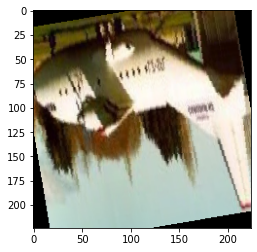

In [7]:
image = train_dataset[3][0].permute(1, 2, 0)
print(train_dataset[3][1])
plt.imshow(image)
plt.show()

In [8]:
class ClassifierModel(torch.nn.Module):
    
    def __init__(self, output_size):
        super(ClassifierModel, self).__init__()
        self.vgg11 = models.vgg11()
        self.vgg11.classifier[6] = nn.Linear(4096, output_size)

    def forward(self, input):
        output = self.vgg11(input)
        return output

In [9]:
def accuracy(outputs, labels):
    _, preds = torch.max(F.log_softmax(outputs, dim=1), dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))
  
def predicts(outputs):
    _, preds = torch.max(F.log_softmax(outputs, dim=1), dim=1)
    return preds
  
criterion = torch.nn.CrossEntropyLoss()

In [10]:
def train(model, batch, optimizer):
    model.train()
    optimizer.zero_grad()
    inputs, labels = batch
    inputs = inputs.cuda()
    labels = labels.cuda()
    outputs = model(inputs)
    l = criterion(outputs, labels)
    l.backward()
    optimizer.step()
    return l


def evaluate(model, batch, optimizer):
    model.eval()
    inputs, labels = batch
    inputs = inputs.cuda()
    labels = labels.cuda()
    outputs = model(inputs)
    a = accuracy(outputs, labels)
    l = criterion(outputs, labels)
    return a, l

In [11]:
model = ClassifierModel(8)
model.cuda()
model.load_state_dict(torch.load('drive/MyDrive/DL/temp3.pt'))

<All keys matched successfully>

In [12]:
LEARNING_RATE = 0.00001
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
epoches = 100

train_loader = DataLoader(train_dataset, batch_size=100, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=100)

for epoch in range(epoches):
    print('Epoch:', epoch + 1)
    c = 0
    for batch in train_loader:
        l = train(model, batch, optimizer)
        c += len(batch[0])
        print("[%d/%d] Loss: %.2f" % (c, len(train_dataset), l.item()))
      
    for batch in train_loader:
        a, l = evaluate(model, batch, optimizer)
        print("Train Loss: %.2f, Train Accuracy: %.2f" % (l.item(), a.item()))
        break

    acc = 0
    loo = 0
    d = 0
    for batch in val_loader:
        a, l = evaluate(model, batch, optimizer)
        acc += a.item()
        loo += l.item()
        d += 1
    print("Val Loss: %.2f, Val Accuracy: %.2f" % (loo / d, acc / d))
    
    torch.save(model.state_dict(), 'drive/MyDrive/DL/temp3.pt')

Epoch: 1
[100/5519] Loss: 0.02
[200/5519] Loss: 0.08
[300/5519] Loss: 0.09
[400/5519] Loss: 0.08
[500/5519] Loss: 0.02
[600/5519] Loss: 0.07


KeyboardInterrupt: ignored

In [15]:
model = ClassifierModel(8)
model.cuda()
model.load_state_dict(torch.load('drive/MyDrive/DL/temp3.pt'))
for param in model.parameters():
    param.requires_grad = False
model.eval()
print(model)

ClassifierModel(
  (vgg11): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): ReLU(inplace=True)
      (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (6): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (7): ReLU(inplace=True)
      (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (9): ReLU(inplace=True)
      (10): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (11): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (12): ReLU(inplace=True)
      (13): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (14): ReLU(inplace=True)
      (15): MaxPool2d(kern

In [16]:
results = {}

def hook(name):
    def _hook(model, input, output):
        results[name] = output
    return _hook

model.vgg11.features[0].register_forward_hook(hook('r0'))
model.vgg11.features[8].register_forward_hook(hook('r8'))
model.vgg11.features[16].register_forward_hook(hook('r16'))
model.vgg11.avgpool.register_forward_hook(hook('avgpool'))
model.vgg11.classifier[3].register_forward_hook(hook('l3'))

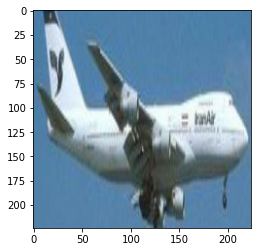

In [17]:
image = val_dataset[59][0][None,:,:,:].cuda()

im_0 = torch.autograd.Variable(torch.zeros(image.shape).cuda().float(), requires_grad=True)
im_8 = torch.autograd.Variable(torch.zeros(image.shape).cuda().float(), requires_grad=True)
im_16 = torch.autograd.Variable(torch.zeros(image.shape).cuda().float(), requires_grad=True)
im_avgpool = torch.autograd.Variable(torch.zeros(image.shape).cuda().float(), requires_grad=True)
im_l3 = torch.autograd.Variable(torch.zeros(image.shape).cuda().float(), requires_grad=True)

plt.imshow(image[0].detach().cpu().permute(1, 2, 0))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.009582


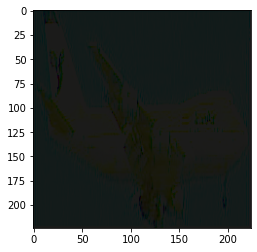

tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.006507


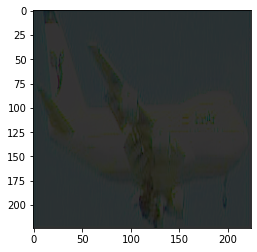

tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.004427


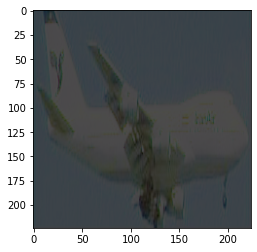

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003028


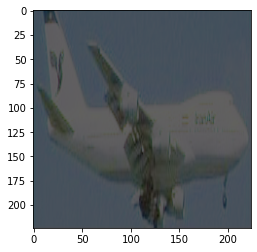

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002066


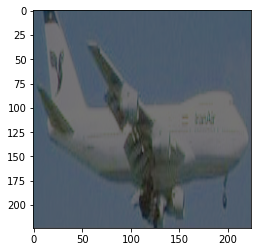

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001400


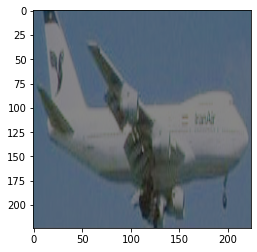

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000940


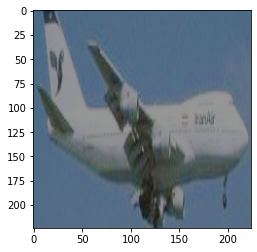

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000624


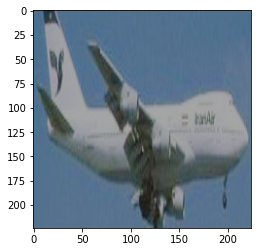

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000408


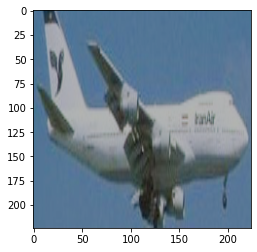

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000263


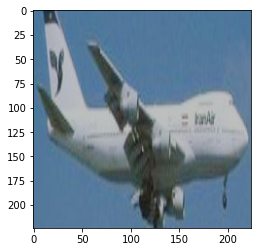

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000167


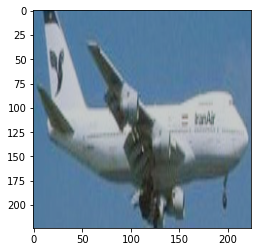

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000104


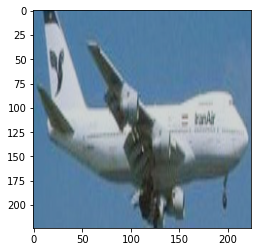

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000063


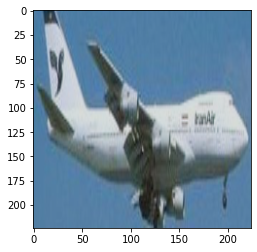

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000038


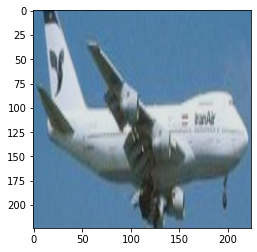

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000022


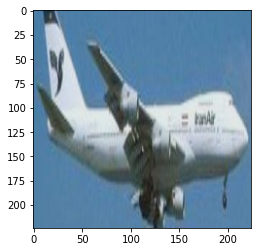

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000012


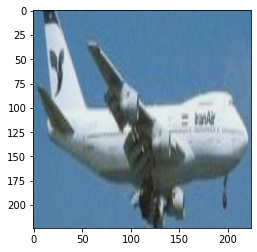

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000007


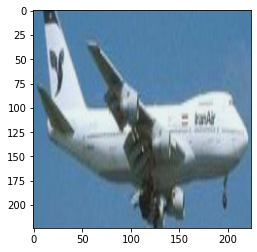

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000004


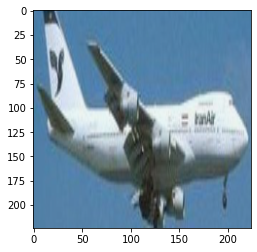

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000002


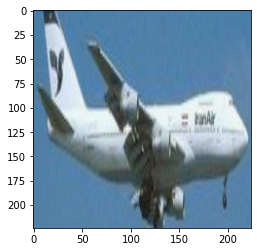

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000001


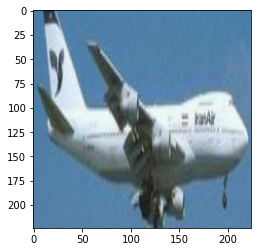

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000000


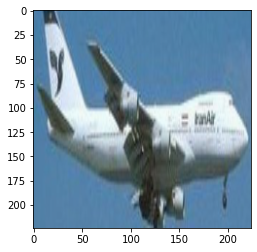

tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000000


KeyboardInterrupt: ignored

In [ ]:
LEARNING_RATE = 0.001
optimizer = torch.optim.Adam([im_0], lr=LEARNING_RATE)
epoches = 100000


for epoch in range(epoches):

    l = 0
    size = 100

    for i in range(size):
        out_a = model(image)
        res_a = results['r0'].flatten()
        p_a = predicts(out_a)

        out_b = model(im_0)
        res_b = results['r0'].flatten()
        p_b = predicts(out_b)

        diff = (res_a - res_b) ** 2

        loss = diff.sum() / len(diff)
        l += loss.item()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
    
    print(p_a, p_b)
    print("Loss: %f" % (l / size))

    res = im_0[0].detach().cpu()
    plt.imshow(res.permute(1, 2, 0))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.000756


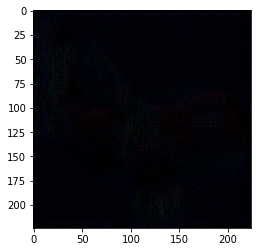

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.000603


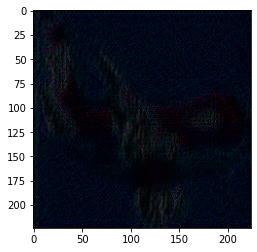

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000468


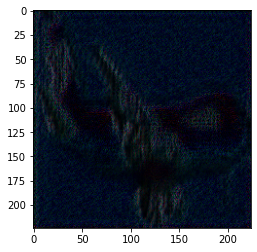

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000396


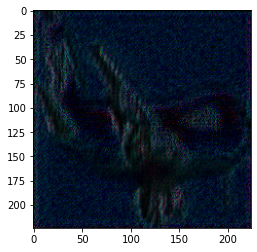

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000348


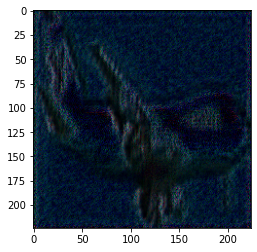

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000311


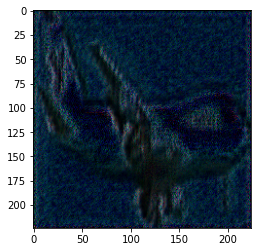

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000282


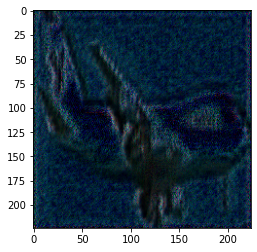

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000257


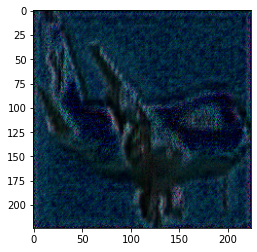

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000236


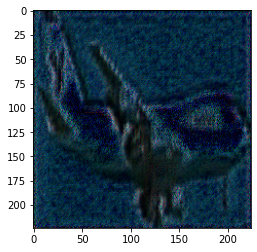

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000218


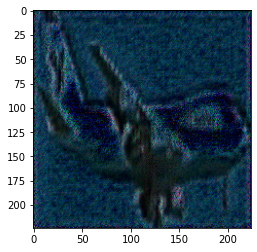

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000202


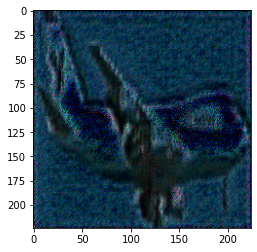

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000189


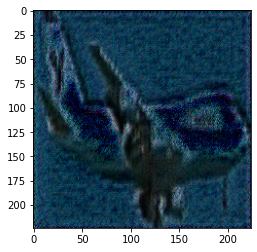

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000177


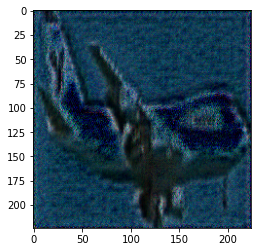

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000168


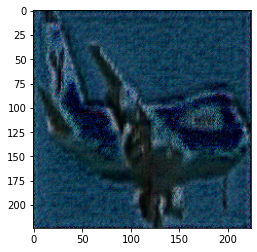

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000159


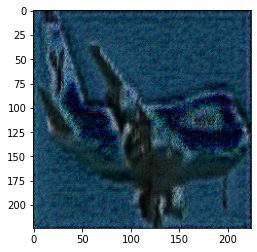

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000151


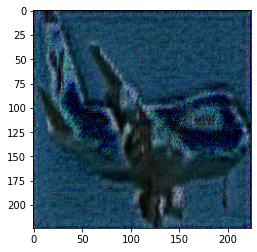

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000145


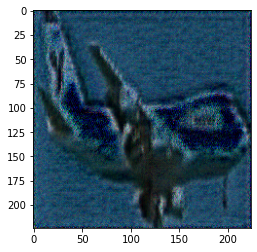

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000139


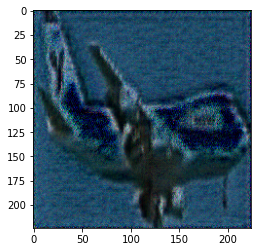

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000133


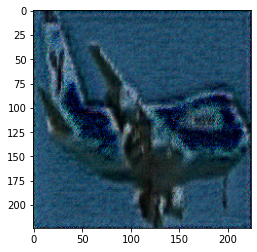

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000129


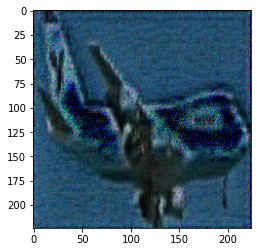

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000125


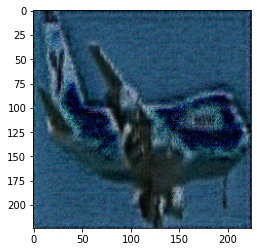

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000121


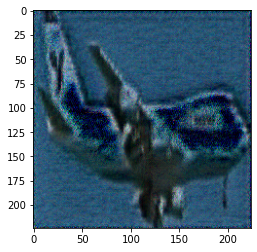

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000117


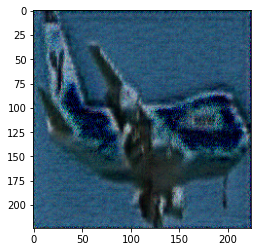

KeyboardInterrupt: ignored

In [ ]:
LEARNING_RATE = 0.001
optimizer = torch.optim.Adam([im_8], lr=LEARNING_RATE)
epoches = 100000

for epoch in range(epoches):

    l = 0
    size = 100

    for i in range(size):
        out_a = model(image)
        res_a = results['r8'].flatten()
        p_a = predicts(out_a)

        out_b = model(im_8)
        res_b = results['r8'].flatten()
        p_b = predicts(out_b)

        diff = (res_a - res_b) ** 2

        loss = diff.sum() / len(diff)
        l += loss.item()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    print(p_a, p_b)
    print("Loss: %f" % (l / size))

    res = im_8[0].detach().cpu()
    plt.imshow(res.permute(1, 2, 0))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.028997


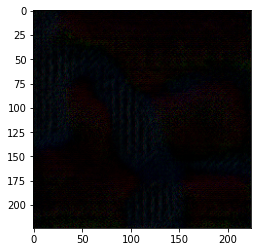

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.019312


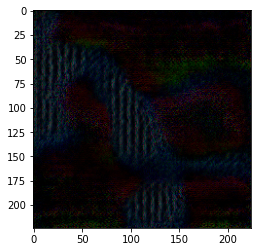

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.012892


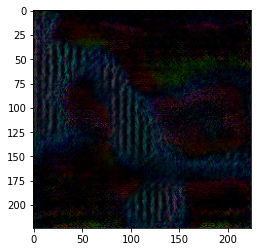

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.010635


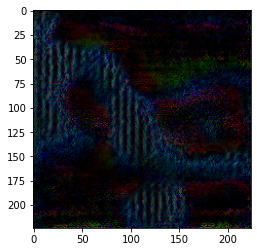

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.009075


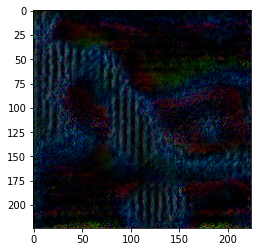

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.007490


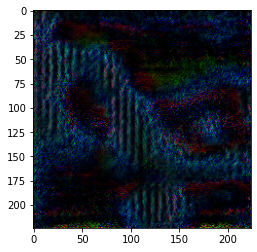

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.005776


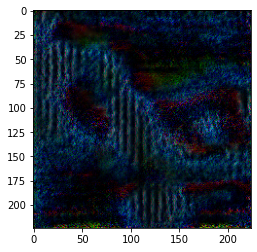

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.004217


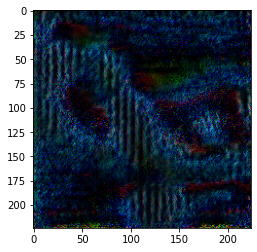

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003005


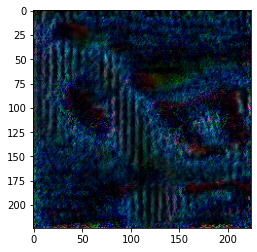

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002246


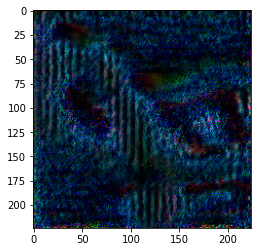

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001756


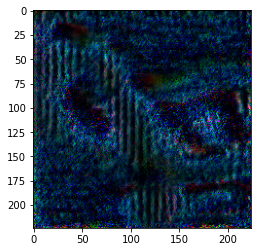

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001433


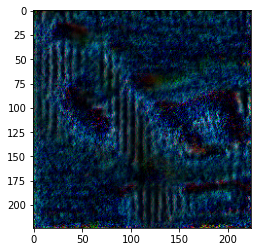

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001215


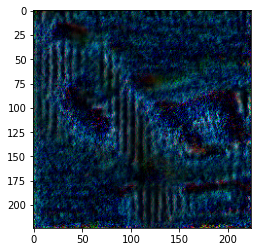

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001059


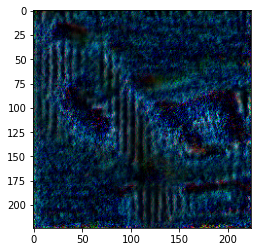

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000947


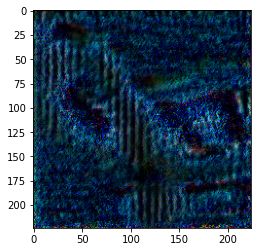

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000863


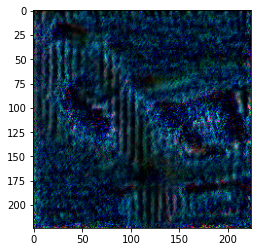

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000794


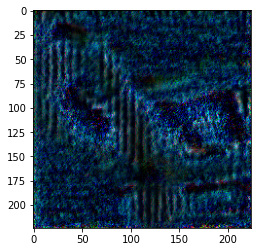

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000736


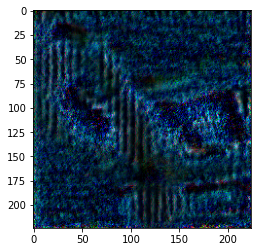

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000687


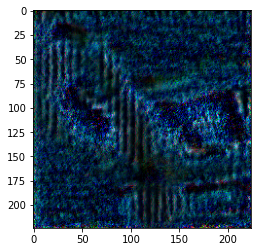

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000645


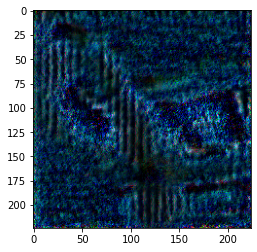

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000608


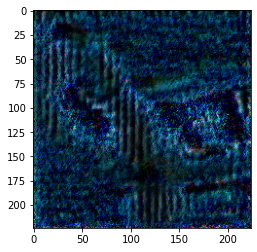

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000575


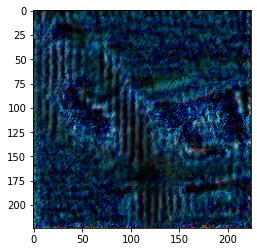

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000547


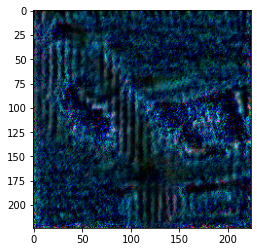

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000521


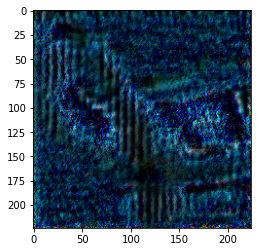

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000498


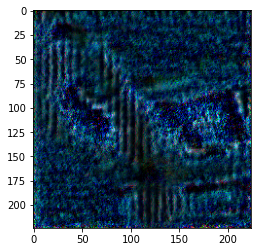

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000478


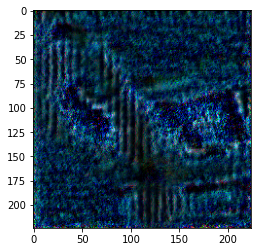

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000459


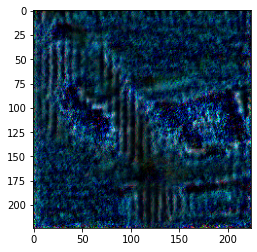

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000443


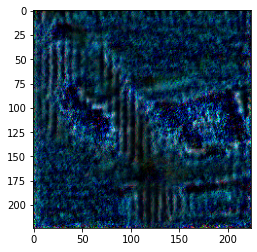

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000428


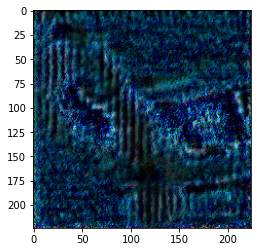

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000414


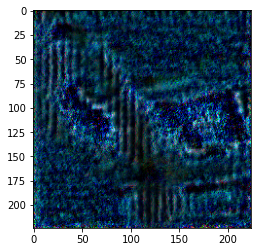

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000401


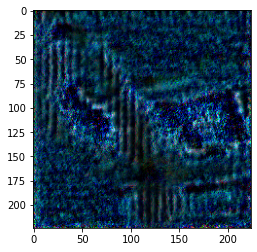

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000389


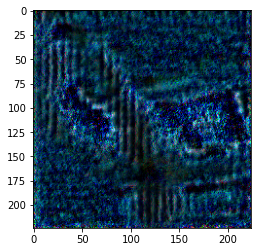

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000378


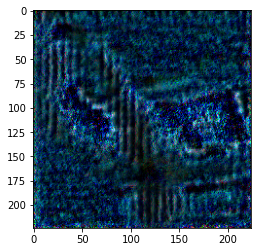

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000367


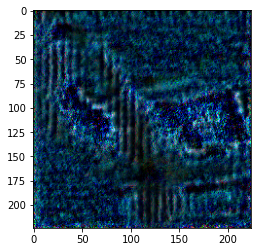

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000358


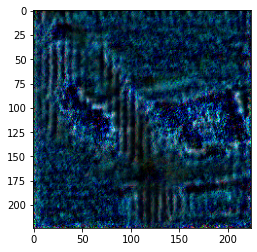

KeyboardInterrupt: ignored

In [ ]:
LEARNING_RATE = 0.001
optimizer = torch.optim.Adam([im_16], lr=LEARNING_RATE)
epoches = 100000

for epoch in range(epoches):

    l = 0
    size = 100

    for i in range(size):
        out_a = model(image)
        res_a = results['r16'].flatten()
        p_a = predicts(out_a)

        out_b = model(im_16)
        res_b = results['r16'].flatten()
        p_b = predicts(out_b)

        diff = (res_a - res_b) ** 2

        loss = diff.sum() / len(diff)
        l += loss.item()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    print(p_a, p_b)
    print("Loss: %f" % (l / size))

    res = im_16[0].detach().cpu()
    plt.imshow(res.permute(1, 2, 0))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.015918


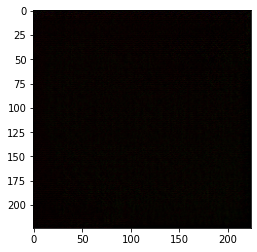

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.015165


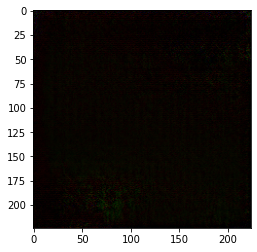

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.014960


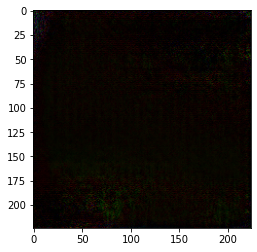

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.014748


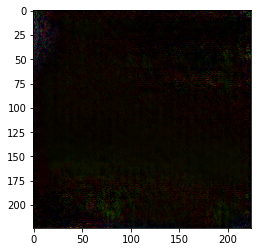

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([2], device='cuda:0')
Loss: 0.014412


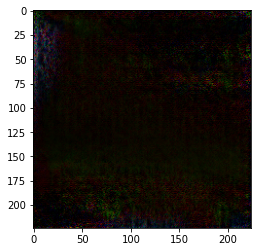

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([4], device='cuda:0')
Loss: 0.013410


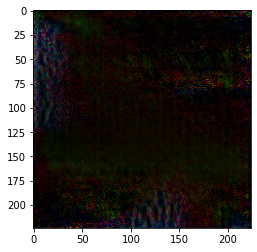

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([4], device='cuda:0')
Loss: 0.012030


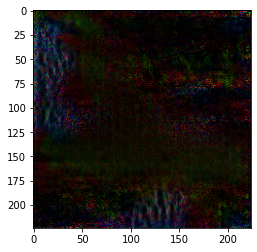

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.010159


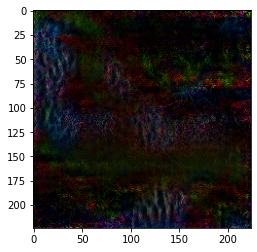

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.008176


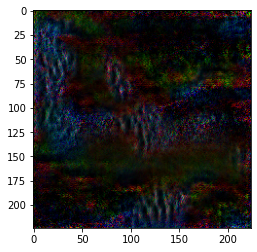

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.006598


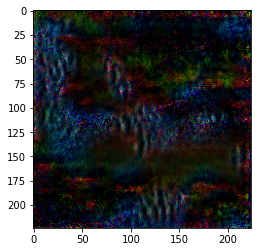

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.004928


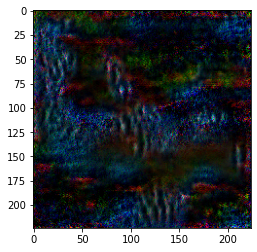

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003374


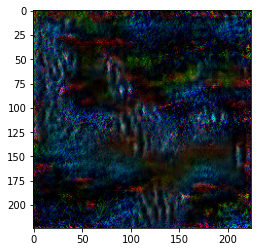

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002299


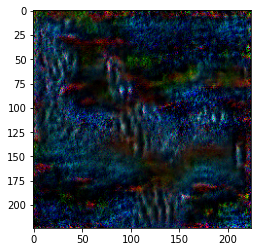

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001565


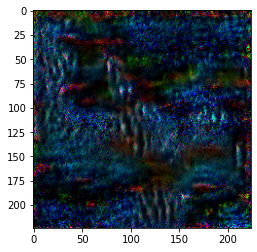

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001062


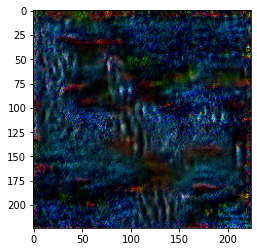

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000742


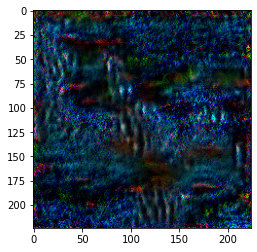

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000558


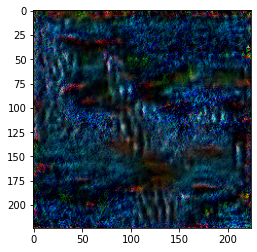

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000443


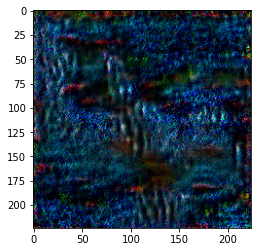

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000364


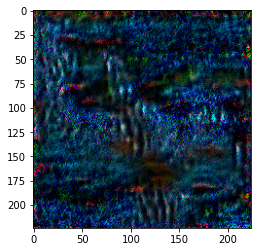

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000306


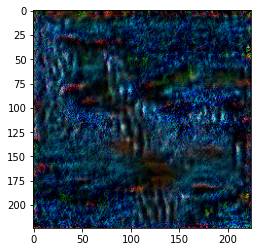

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000263


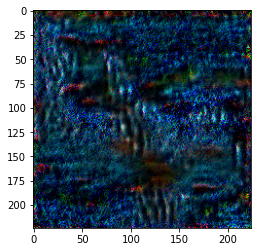

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000231


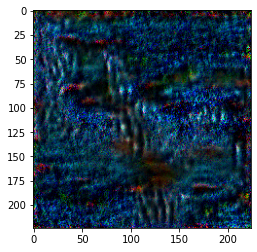

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000207


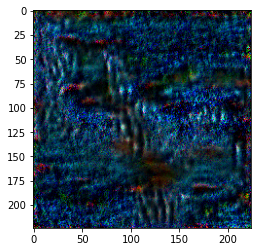

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000186


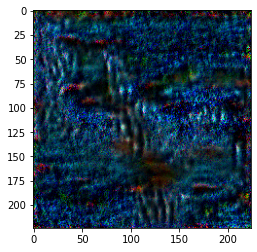

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000170


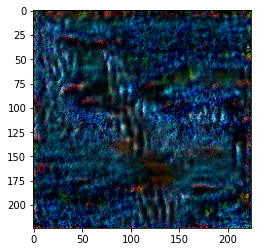

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000156


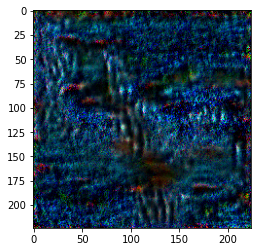

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000143


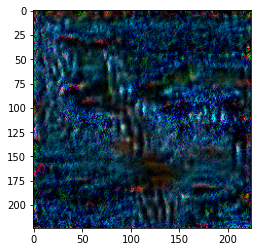

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000132


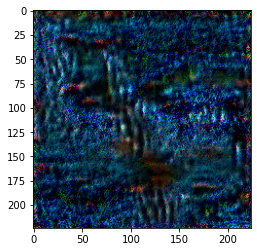

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000123


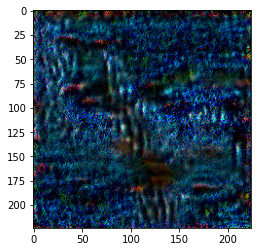

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000116


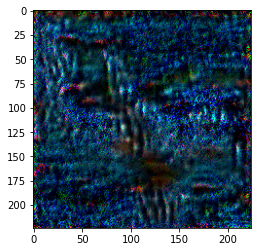

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.000108


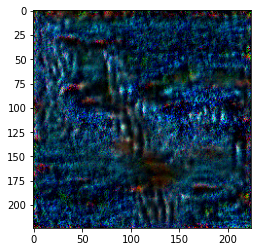

KeyboardInterrupt: ignored

In [18]:
LEARNING_RATE = 0.001
optimizer = torch.optim.Adam([im_avgpool], lr=LEARNING_RATE)
epoches = 100000

for epoch in range(epoches):

    l = 0
    size = 100

    for i in range(size):
        out_a = model(image)
        res_a = results['avgpool'].flatten()
        p_a = predicts(out_a)

        out_b = model(im_avgpool)
        res_b = results['avgpool'].flatten()
        p_b = predicts(out_b)
    
        diff = (res_a - res_b) ** 2

        loss = diff.sum() / len(diff)
        l += loss.item()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    print(p_a, p_b)
    print("Loss: %f" % (l / size))

    res = im_avgpool[0].detach().cpu()
    plt.imshow(res.permute(1, 2, 0))
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.983039


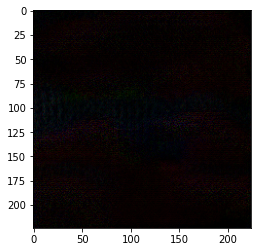

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.220983


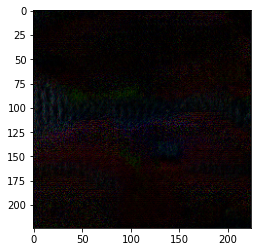

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.082584


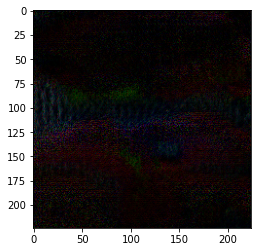

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.066963


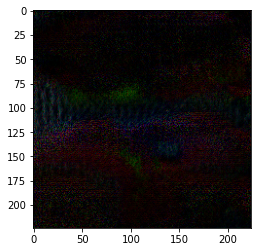

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.058834


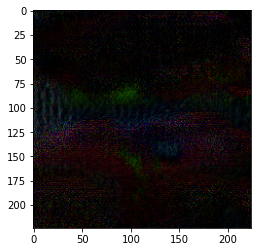

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.053618


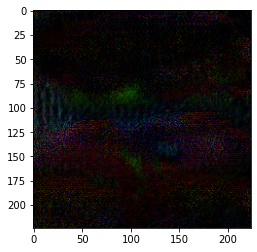

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.049563


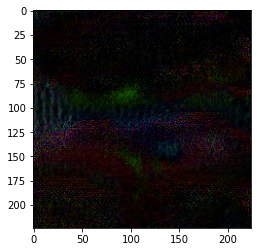

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.046076


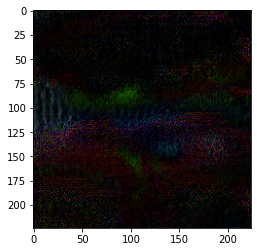

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.043263


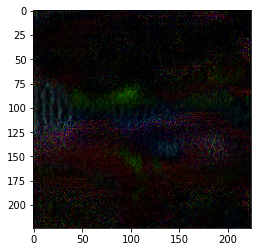

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.040832


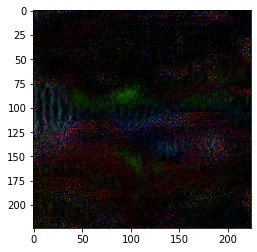

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.038607


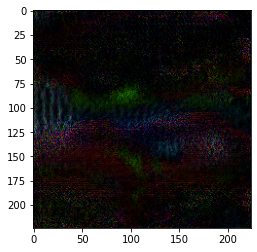

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.036539


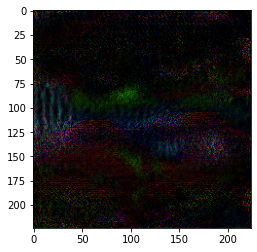

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.034662


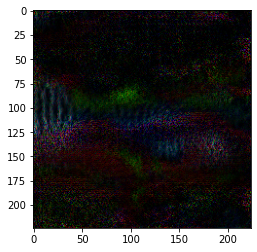

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.032942


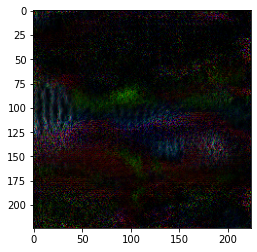

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.031189


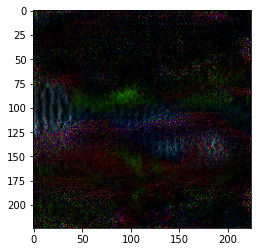

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.029434


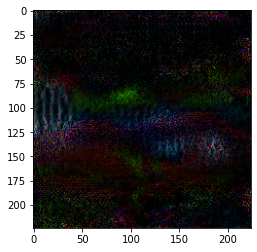

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.027681


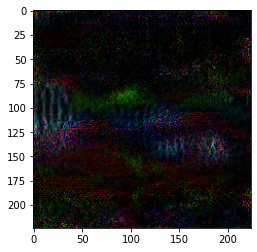

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.026091


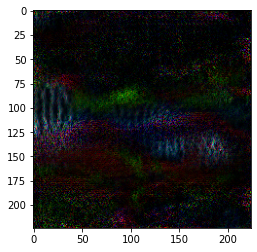

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.024841


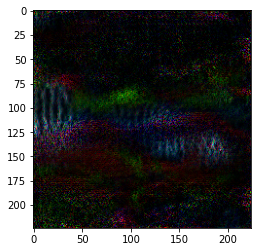

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.023895


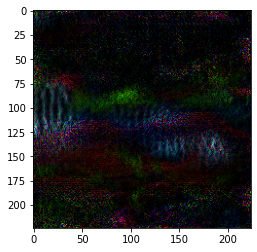

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.023074


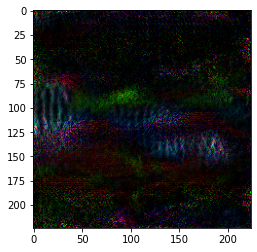

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.022336


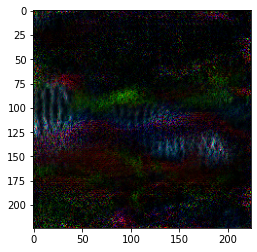

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.021615


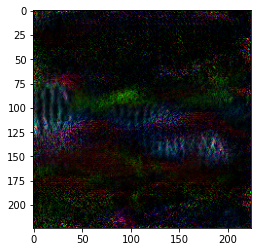

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.020875


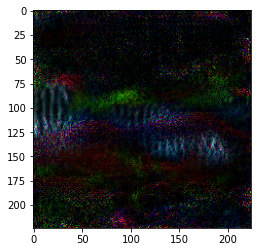

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.020179


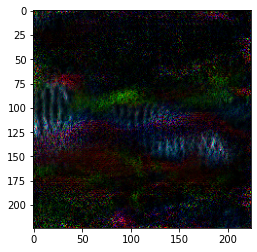

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.019486


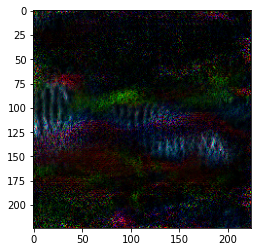

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.018777


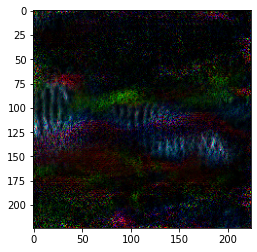

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.018031


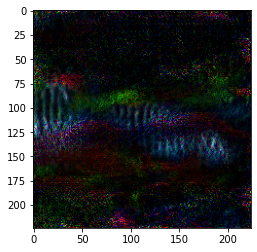

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.017329


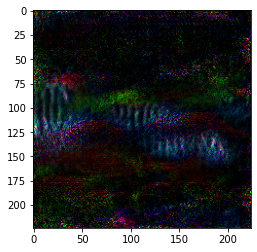

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.016647


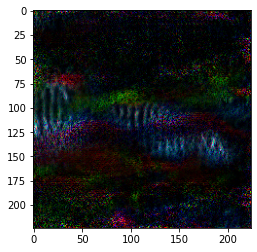

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.016050


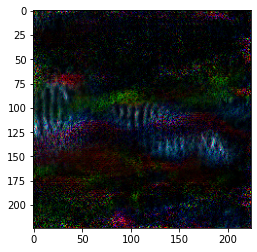

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.015512


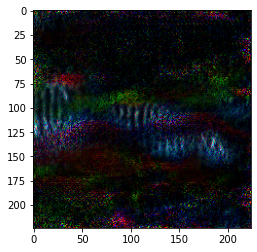

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.014976


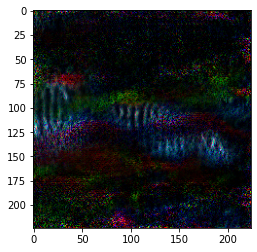

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.014484


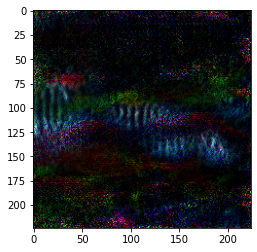

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.014045


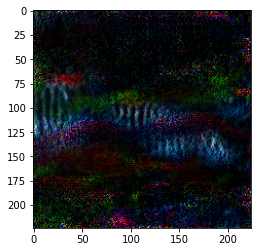

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.013629


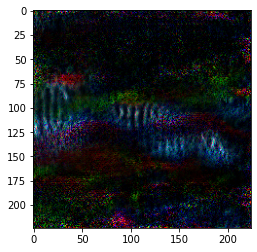

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.013214


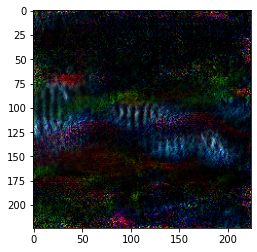

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.012824


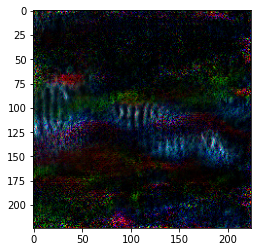

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.012445


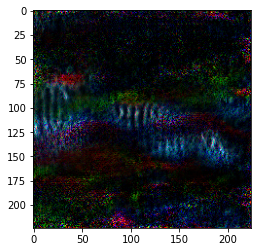

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.012043


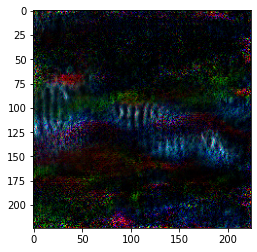

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.011628


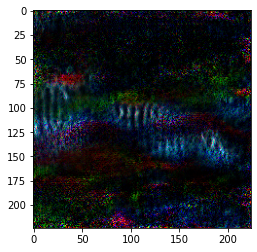

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.011217


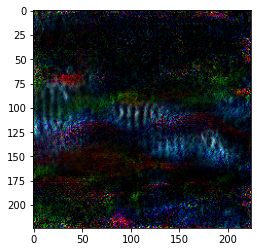

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.010785


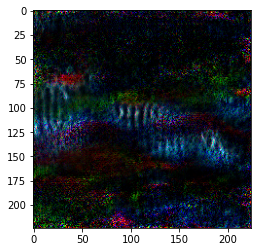

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.010357


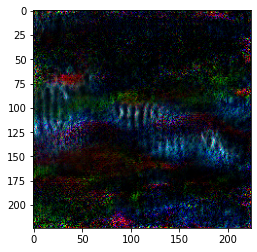

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.009951


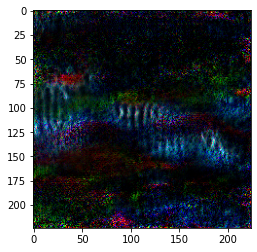

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.009520


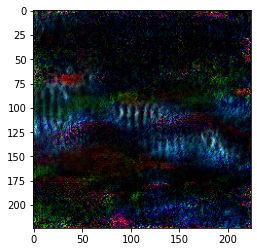

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.009008


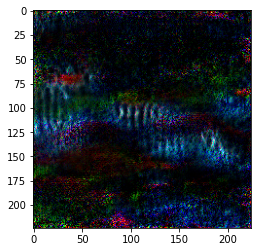

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.008415


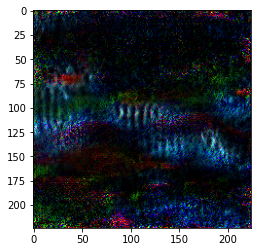

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.007885


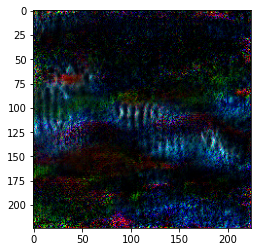

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.007412


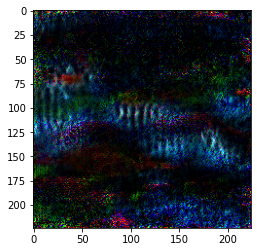

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.006980


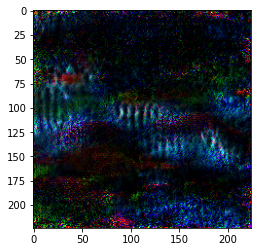

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.006563


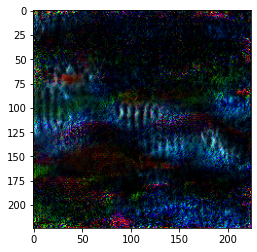

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.006125


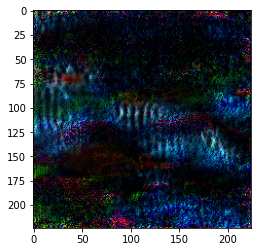

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.005604


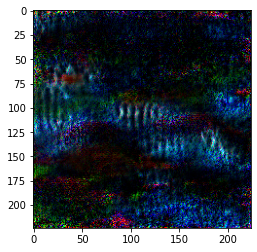

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.005008


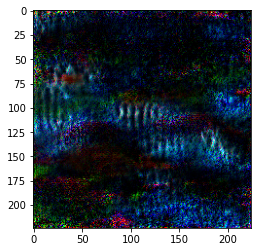

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.004457


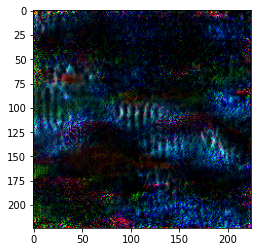

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003938


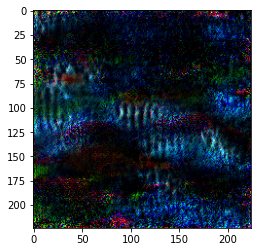

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003484


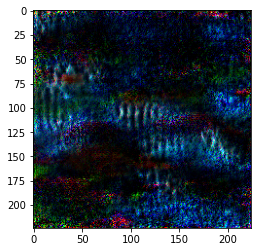

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.003131


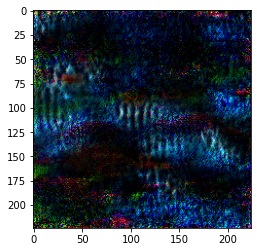

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002848


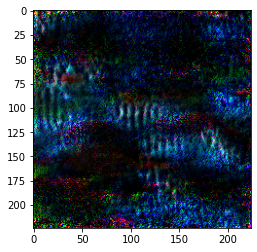

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002603


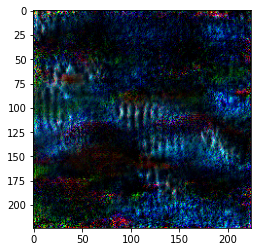

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002411


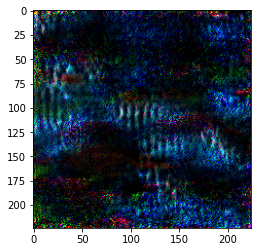

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002247


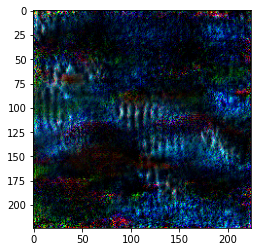

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.002100


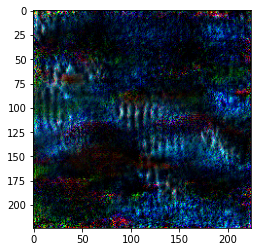

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([0], device='cuda:0') tensor([0], device='cuda:0')
Loss: 0.001970


KeyboardInterrupt: ignored

In [19]:
LEARNING_RATE = 0.001
optimizer = torch.optim.Adam([im_l3], lr=LEARNING_RATE)
epoches = 100000

for epoch in range(epoches):

    l = 0
    size = 100

    for i in range(size):
        out_a = model(image)
        res_a = results['l3'].flatten()
        p_a = predicts(out_a)

        out_b = model(im_l3)
        res_b = results['l3'].flatten()
        p_b = predicts(out_b)
    
        diff = (res_a - res_b) ** 2

        loss = diff.sum() / len(diff)
        l += loss.item()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

    print(p_a, p_b)
    print("Loss: %f" % (l / size))

    res = im_l3[0].detach().cpu()
    plt.imshow(res.permute(1, 2, 0))
    plt.show()